# Helper functions

In [4]:
import numpy as np
import open3d as o3d
from pyproj import Transformer
import pandas as pd
from scipy.spatial import ConvexHull, distance # Import distance for cdist
from matplotlib.path import Path
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib import rcParams
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import griddata
from tqdm import tqdm
import random
import time # For timing the operations

# Import Plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots


# Optional: prettier fonts for publication-style visuals
rcParams.update({
    'font.family': 'serif',
    'font.size': 12,
    'axes.titlesize': 14,
    'axes.labelsize': 12
})

# --- Helper Functions (Necessary for the algorithms to run) ---

def wgs_to_utm(df, lat_col='latitude', lon_col='longitude', alt_col='lidar(m)'):
    transformer = Transformer.from_crs("epsg:4326", "epsg:32633", always_xy=True)
    lon, lat, alt = df[lon_col].values, df[lat_col].values, df[alt_col].values
    x, y = transformer.transform(lon, lat)
    return np.stack([x, y, alt], axis=1).astype(np.float32)

def extract_detector_positions(df):
    return wgs_to_utm(df, lat_col='latitude', lon_col='longitude', alt_col='height_wgs84(m)')

def create_reconstruction_grid_extent(min_x, max_x, min_y, max_y, voxel_size=0.25):
    grid_x = np.arange(min_x + voxel_size/2, max_x + voxel_size/2, voxel_size)
    grid_y = np.arange(min_y + voxel_size/2, max_y + voxel_size/2, voxel_size)
    bounds_dict = {"x": (min_x, max_x), "y": (min_y, max_y)}
    return grid_x, grid_y, bounds_dict

def _kaczmarz_base(detectors, grid_points, b, isotope):
    m, n = detectors.shape[0], grid_points.shape[0]
    x = np.zeros(n, dtype=np.float32)

    if isotope.lower() == "cs":
        emission_prob = 0.851
        mu_over_rho = 0.07925
    elif isotope.lower() == "co":
        emission_prob = 0.999
        mu_over_rho = 0.05270
    else:
        raise ValueError("Invalid isotope. Use 'cs' or 'co'.")

    rho_air = 0.001225
    mu_L = mu_over_rho * rho_air * 100
    return x, m, n, emission_prob, mu_L

def _get_A_matrix(detectors, grid_points, emission_prob, mu_L):
    """Precomputes the A matrix where A[i, j] represents the contribution
    from grid point j to detector i. This is the main optimization."""
    print("\nPre-computing A matrix...")
    start_time = time.time()
    dists = np.linalg.norm(detectors[:, None, :] - grid_points[None, :, :], axis=2) + 1e-6
    atten = np.exp(-mu_L * dists)
    A_matrix = emission_prob / (4 * np.pi * dists**2) * atten
    end_time = time.time()
    print(f"A matrix pre-computation completed in {end_time - start_time:.2f} seconds. Shape: {A_matrix.shape}")
    return A_matrix

def calculate_system_residual(x_recon, b, A_matrix):
    """Calculates the L2 norm of the residual (||b - Ax||_2) using the pre-computed A_matrix."""
    predicted_b = A_matrix @ x_recon
    full_residual = b - predicted_b
    return np.linalg.norm(full_residual)


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# Kaczmarz definitions

In [ ]:
# Modified to return residuals_per_iteration
def kaczmarz_cyclic_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Cyclic Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for i in range(m):
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)


# Modified to return residuals_per_iteration
def kaczmarz_upsweep_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Upsweep Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for i in range(m): # Forward sweep
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        for i in range(m - 1, -1, -1): # Backward sweep
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

# Modified to return residuals_per_iteration
def kaczmarz_randomized_nn(detectors, grid_points, b, A_matrix, n_iter=100, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    detector_indices = list(range(m))
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Randomized Kaczmarz NN ({isotope_str.upper()}) Iterations"):
        for _ in range(m): # A full pass means m updates
            i = random.choice(detector_indices)
            print(f"Updating detector {i}")
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

# Modified to return residuals_per_iteration
def kaczmarz_relaxation(detectors, grid_points, b, A_matrix, relx, n_iter=100, isotope_str="cs"):
    x, m, n, _, _ = _kaczmarz_base(detectors, grid_points, b, isotope=isotope_str)
    residuals_per_iteration = []
    for it in tqdm(range(n_iter), desc=f"Kaczmarz Relaxation (relx={relx:.2f}, {isotope_str.upper()}) Iterations"):
        for i in range(m):
            A_i = A_matrix[i, :]
            A_i_norm_sq = np.sum(A_i**2)
            if A_i_norm_sq == 0: continue
            residual = b[i] - A_i @ x
            x += relx * (residual / A_i_norm_sq) * A_i
            x = np.maximum(0, x)  # Ensure non-negativity
        residuals_per_iteration.append(calculate_system_residual(x, b, A_matrix))
    return x, np.array(residuals_per_iteration)

def kaczmarz_downsweep(A, b, x, omega=1.0):
    """
    One down-sweep Kaczmarz iteration.
    """
    m, n = A.shape
    for i in range(m):
        Ai = A[i]
        Ai_norm_sq = np.linalg.norm(Ai)**2
        if Ai_norm_sq == 0:
            continue
        residual = b[i] - Ai @ x
        x = x + (omega * residual / Ai_norm_sq) * Ai
        x = np.maximum(0, x)  # Ensure non-negativity
    return x

def kaczmarz_upsweep(A, b, x, omega=1.0):
    """
    One up-sweep Kaczmarz iteration.
    """
    m, n = A.shape
    for i in reversed(range(m)):
        Ai = A[i]
        Ai_norm_sq = np.linalg.norm(Ai)**2
        if Ai_norm_sq == 0:
            continue
        residual = b[i] - Ai @ x
        x = x + (omega * residual / Ai_norm_sq) * Ai
        x = np.maximum(0, x)  # Ensure non-negativity
    return x

def twin_error_gauge_kaczmarz(A, b, omega=1.0, max_iters=1000, slack=5):
    """
    Twin Kaczmarz Algorithm using Error Gauge as stopping rule.
    """
    m, n = A.shape
    x_down = np.zeros(n)
    x_up = np.zeros(n)
    best_x_down = None
    best_x_up = None
    min_gauge = np.inf
    slack_counter = slack

    gauge_history = []
    
    for k in tqdm(range(max_iters), desc="TEG Kaczmarz Sweeps"):
        x_down = kaczmarz_downsweep(A, b, x_down, omega)
        x_up = kaczmarz_upsweep(A, b, x_up, omega)

        gauge = np.linalg.norm(x_down - x_up)
        gauge_history.append(gauge)

        if gauge < min_gauge:
            min_gauge = gauge
            best_x_down = x_down.copy()
            best_x_up = x_up.copy()
            slack_counter = slack  # Reset slack counter when finding new min
        else:
            slack_counter -= 1  # Count down if no improvement

        if slack_counter == 0:
            print(f"Stopping at iteration {k+1} with minimal gauge {min_gauge:.4e}")
            break

    x_final = 0.5 * (best_x_down + best_x_up)
    return x_final, gauge_history, min_gauge

def kaczmarz_downsweep_early_stop(A, b, omega=1.0, max_iters=1000, slack=50, tolerance=0.5):
    """
    Performs Kaczmarz down-sweeps with an early stopping rule based on a
    minimal change in the residual.
    
    Args:
        A (np.ndarray): System matrix.
        b (np.ndarray): Measurement vector.
        omega (float): Relaxation parameter.
        max_iters (int): Maximum number of sweeps to perform.
        slack (int): Number of iterations to tolerate a change below tolerance.
        tolerance (float): The minimum required change in residual to count as improvement.
        
    Returns:
        x_recon_best (np.ndarray): The solution with the minimum residual.
        min_residual (float): The L2 norm of the minimum residual.
        residual_history (list): A list of the residual norms over iterations.
    """
    m, n = A.shape
    x = np.zeros(n)
    best_x = np.zeros(n)
    min_residual = float('inf')
    slack_counter = slack
     
    residual_history = []
    
    for k in tqdm(range(max_iters), desc="Kaczmarz Downsweep with Early Stop"):
        # Single down-sweep
        for i in range(m):
            Ai = A[i]
            Ai_norm_sq = np.sum(Ai**2)
            if Ai_norm_sq == 0:
                continue
            residual = b[i] - Ai @ x
            x = x + (omega * residual / Ai_norm_sq) * Ai
            x = np.maximum(0, x)  # Non-negativity constraint
        
        # Calculate full system residual after each sweep
        current_residual = calculate_system_residual(x, b, A)
        residual_history.append(current_residual)
        
        # Check for a significant improvement
        if (min_residual - current_residual) > tolerance:
            min_residual = current_residual
            best_x = x.copy()
            slack_counter = slack  # Reset slack counter on improvement
        else:
            slack_counter -= 1     # Decrement if change is too small
        
        # Early stopping condition
        if slack_counter <= 0:
            print(f"Stopping early at iteration {k+1} due to minimal change in residual.")
            break
            
    return best_x, min_residual, residual_history

# Plotting helpers

In [2]:
# --- Plotting Functions (for visualization) ---

def plot_2d_reconstruction_on_terrain_map(x_recon, xx_mesh, yy_mesh, Z_terrain, 
                                        grid_points_for_reconstruction, title="2D Reconstruction on Terrain",
                                        threshold_percentage=0.0):
    print(f"\nCreating 2D terrain map with reconstruction overlay for {title} (Threshold: {threshold_percentage:.1f}%) ...")
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    if threshold_percentage > 0:
        max_intensity = np.max(x_recon_clamped_for_plot)
        if max_intensity > 0:
            threshold_val = (threshold_percentage / 100.0) * max_intensity
            x_recon_clamped_for_plot[x_recon_clamped_for_plot < threshold_val] = 0
    fig, ax = plt.subplots(figsize=(6, 6))
    contour_levels = 50
    terrain_contour = ax.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)
    fig.colorbar(terrain_contour, ax=ax, label="Elevation (m)", pad=0.05)
    if np.max(x_recon_clamped_for_plot) == np.min(x_recon_clamped_for_plot):
        scatter_colors = np.zeros_like(x_recon_clamped_for_plot)
    else:
        norm = mcolors.Normalize(vmin=np.min(x_recon_clamped_for_plot), vmax=np.max(x_recon_clamped_for_plot))
        scatter_colors = norm(x_recon_clamped_for_plot)
    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    scatter_plot = ax.scatter(scatter_x, scatter_y, c=x_recon_clamped_for_plot, cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(scatter_plot, ax=ax, label="Reconstructed Activity", pad=0.15)
    ax.set_xlabel("UTM Easting (m)")
    ax.set_ylabel("UTM Northing (m)")
    ax.set_title(title)
    ax.set_aspect('equal', adjustable='box')
    plt.tight_layout()
    plt.show()

def plot_3d_plotly_reconstruction(x_recon, xx_mesh, yy_mesh, Z_terrain, 
                                  grid_points_for_reconstruction, title="3D Plotly Reconstruction"):
    print(f"\nCreating Plotly 3D interactive plot for {title}...")
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    surface_trace = go.Surface(x=xx_mesh, y=yy_mesh, z=Z_terrain, colorscale='plasma', showscale=False, name='plasma', opacity=0.8)
    scatter_trace = go.Scatter3d(
        x=grid_points_for_reconstruction[:, 0],
        y=grid_points_for_reconstruction[:, 1],
        z=grid_points_for_reconstruction[:, 2],
        mode='markers',
        marker=dict(size=3, color=x_recon_clamped_for_plot, colorscale='Jet', colorbar=dict(title='Activity'), showscale=True, opacity=1.0),
        name='Reconstruction Activity'
    )
    fig = go.Figure(data=[surface_trace, scatter_trace])
    fig.update_layout(
        title=title,
        scene=dict(xaxis_title='Easting (m)', yaxis_title='Northing (m)', zaxis_title='Elevation (m)', aspectmode='data')
    )
    fig.show()

def plot_residuals_over_iterations(residual_data_dict, n_iter, title="Residuals Over Iterations"):
    """
    Plots the L2 norm of the residuals for different algorithms over iterations.

    Args:
        residual_data_dict (dict): A dictionary where keys are algorithm names (str)
                                   and values are arrays/lists of residual norms per iteration.
        n_iter (int): The total number of iterations.
        title (str): Title for the plot.
    """
    print(f"\nPlotting {title}...")
    plt.figure(figsize=(10, 6))
    iterations = np.arange(1, n_iter + 1)

    for algo_name, residuals in residual_data_dict.items():
        if residuals.size > 0: # Ensure there's data to plot
            plt.plot(iterations, residuals, label=algo_name, marker='o', markersize=4, linestyle='-')
        else:
            print(f"Warning: No residual data for {algo_name}. Skipping plot for this algorithm.")


    plt.xlabel("Iteration Number")
    plt.ylabel("Residual Norm $||b - Ax||_2$ (Log Scale)")
    plt.title(title)
    plt.yscale('log') # Use log scale for residuals
    plt.legend()
    plt.grid(True, which="both", ls="-", alpha=0.7)
    plt.tight_layout()
    plt.show()

def plot_reconstruction_and_gauge(x_recon, gauge_history, xx_mesh, yy_mesh, Z_terrain, 
                                  grid_points, detectors, b_values, title, min_gauge):
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(title, fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=50, cmap='terrain', alpha=0.8)
    
    x_recon_clamped = np.maximum(0, x_recon)
    scatter_x = grid_points[:, 0]
    scatter_y = grid_points[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped, 
                                      cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity")
    
    ax1.set_title("Final Reconstruction")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')
    
    # --- Right Subplot: Twin Error Gauge History ---
    ax2.plot(gauge_history, label="Twin Error Gauge Norm")
    ax2.set_title(f"Gauge History (Min: {min_gauge:.4e})")
    ax2.set_xlabel("Number of Sweeps")
    ax2.set_ylabel("Gauge Norm")
    ax2.set_yscale('log') # Log scale is often useful for visualizing convergence
    ax2.grid(True)
    ax2.legend()
    
    plt.tight_layout()
    plt.show()


# --- Plotting Function (Modified for Residual History) ---
def plot_reconstruction_and_history(x_recon, history, xx_mesh, yy_mesh, Z_terrain, 
                                    grid_points, detectors, b_values, title, min_value):
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(title, fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=50, cmap='terrain', alpha=0.8)
    x_recon_clamped = np.maximum(0, x_recon)
    scatter_x = grid_points[:, 0]
    scatter_y = grid_points[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped, 
                                      cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity")
    ax1.set_title("Final Reconstruction")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')
    
    # --- Right Subplot: Residual History ---
    ax2.plot(history, label="System Residual Norm")
    ax2.set_title(f"Residual History (Min: {min_value:.4e})")
    ax2.set_xlabel("Number of Sweeps")
    ax2.set_ylabel("Residual Norm (log scale)")
    ax2.set_yscale('log')
    ax2.grid(True)
    ax2.legend()
    
    plt.tight_layout()
    plt.show()

# --- Plotting the drone path and intensity beside the reconstruction intensity ---
def plot_reconstruction_and_measurements_side_by_side(x_recon, xx_mesh, yy_mesh, Z_terrain, 
                                                     grid_points_for_reconstruction, detectors, 
                                                     b_values, algo_name, isotope_str,
                                                     threshold_percentage=0.0):
    print(f"\nCreating side-by-side plot for {algo_name} ({isotope_str}) ...")
    
    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    fig.suptitle(f"{algo_name} Reconstruction for {isotope_str.upper()}", fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    # Plot the terrain elevation as a background
    contour_levels = 50
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the reconstructed activity
    x_recon_clamped_for_plot = np.maximum(0, x_recon.copy())
    if threshold_percentage > 0:
        max_intensity = np.max(x_recon_clamped_for_plot)
        if max_intensity > 0:
            threshold_val = (threshold_percentage / 100.0) * max_intensity
            x_recon_clamped_for_plot[x_recon_clamped_for_plot < threshold_val] = 0
            
    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon_clamped_for_plot, 
                                      cmap='hot', s=15, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity", pad=0.05)
    
    ax1.set_title("Reconstruction Map")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')
    
    # --- Right Subplot: Drone Measurements ---
    # Plot the terrain elevation as a background
    ax2.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)
    
    # Plot the drone flight path
    ax2.plot(detectors[:, 0], detectors[:, 1], color='black', linestyle='--', linewidth=1, zorder=2, label='Drone Path')
    
    # Plot the "true hotspot" measurements from the drone
    scatter_drone = ax2.scatter(detectors[:, 0], detectors[:, 1], 
                                c=b_values, cmap='inferno', s=50, alpha=0.8,
                                edgecolors='black', linewidth=0.5, zorder=3)
    
    # Add a colorbar for the drone measurements
    fig.colorbar(scatter_drone, ax=ax2, label="Drone Measurement Intensity (counts)", pad=0.05)
    
    # Add arrow to indicate start of path
    if len(detectors) > 1:
        ax2.arrow(detectors[0, 0], detectors[0, 1], 
                  detectors[1, 0] - detectors[0, 0], detectors[1, 1] - detectors[0, 1],
                  head_width=5, head_length=5, fc='black', ec='black', zorder=4)

    ax2.set_title(f"Drone Measurement Map (Raw {isotope_str.upper()} Data)")
    ax2.set_xlabel("UTM Easting (m)")
    ax2.set_aspect('equal', adjustable='box')
    ax2.legend()
    
    plt.tight_layout()
    plt.show()


# Base initialisation

In [5]:
# --- Main Execution Block ---

print("--- Initializing Data and Grid ---")

# Load data
cloud = o3d.io.read_point_cloud("converted_coloured.ply")
original_terrain_points = np.asarray(cloud.points)
df_brno = pd.read_csv("brno_processed_data_15mAGL(in).csv")
detectors = extract_detector_positions(df_brno)

# --- Cesium (Cs) Data ---
b_cs = df_brno['cs_photo'].values.astype(np.float32)

# --- Cobalt (Co) Data ---
b_co = df_brno['co_photo'].values.astype(np.float32) # Load Cobalt data


# Define grid bounds (with buffer as previously determined)
buffer_distance = 50.0
det_min_x, det_max_x = detectors[:, 0].min(), detectors[:, 0].max()
det_min_y, det_max_y = detectors[:, 1].min(), detectors[:, 1].max()
grid_min_x, grid_max_x = det_min_x - buffer_distance, det_max_x + buffer_distance
grid_min_y, grid_max_y = det_min_y - buffer_distance, det_max_y + buffer_distance

# Create grid and interpolate terrain
grid_x, grid_y, _ = create_reconstruction_grid_extent(grid_min_x, grid_max_x, grid_min_y, grid_max_y, voxel_size=2.0)
xx_mesh, yy_mesh = np.meshgrid(grid_x, grid_y, indexing='ij')
Z_terrain_interpolated = griddata(original_terrain_points[:, :2], original_terrain_points[:, 2], 
                                  (xx_mesh, yy_mesh), method='nearest')
grid_points_for_reconstruction = np.stack([xx_mesh.ravel(), yy_mesh.ravel(), Z_terrain_interpolated.ravel()], axis=1).astype(np.float32)

# Pre-compute A matrices for both Cs and Co
_, _, _, emission_prob_cs, mu_L_cs = _kaczmarz_base(detectors, grid_points_for_reconstruction, b_cs, isotope="cs")
A_matrix_cs = _get_A_matrix(detectors, grid_points_for_reconstruction, emission_prob_cs, mu_L_cs)

_, _, _, emission_prob_co, mu_L_co = _kaczmarz_base(detectors, grid_points_for_reconstruction, b_co, isotope="co")
A_matrix_co = _get_A_matrix(detectors, grid_points_for_reconstruction, emission_prob_co, mu_L_co)

kaczmarz_n_iter = 100 # Number of iterations/passes for all algorithms

--- Initializing Data and Grid ---

Pre-computing A matrix...
A matrix pre-computation completed in 21.71 seconds. Shape: (1813, 63412)

Pre-computing A matrix...
A matrix pre-computation completed in 22.57 seconds. Shape: (1813, 63412)


# Main

## Basic Kaczmarz algorithms - Downsweep, Symmetric, Randomized


--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---

--- Running Kaczmarz Cyclic NN (Cs) ---


Cyclic Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [02:07<00:00,  1.27s/it]


Final Residual (Cyclic NN Cs): 127.0184

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Cs) (Threshold: 0.0%) ...


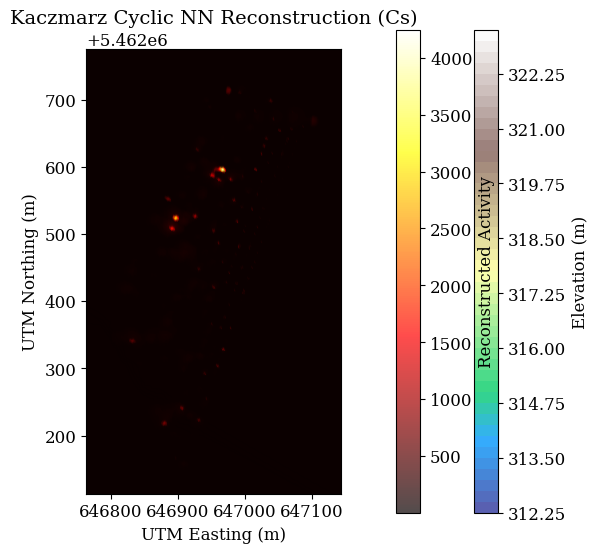


--- Running Kaczmarz Upsweep NN (Cs) ---


Upsweep Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [04:02<00:00,  2.43s/it]


Final Residual (Upsweep NN Cs): 97.0384

Creating 2D terrain map with reconstruction overlay for Kaczmarz Upsweep NN Reconstruction (Cs) (Threshold: 0.0%) ...


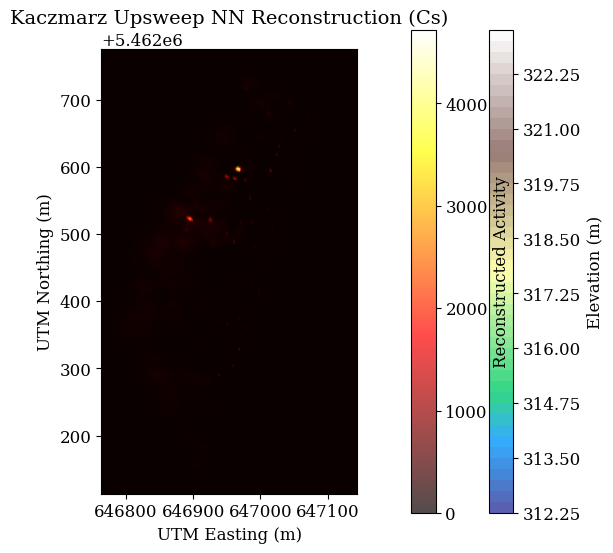


--- Running Kaczmarz Randomized NN (Cs) ---


Randomized Kaczmarz NN (CS) Iterations: 100%|██████████| 100/100 [00:58<00:00,  1.71it/s]


Final Residual (Randomized NN Cs): 94.4395

Creating 2D terrain map with reconstruction overlay for Kaczmarz Randomized NN Reconstruction (Cs) (Threshold: 0.0%) ...


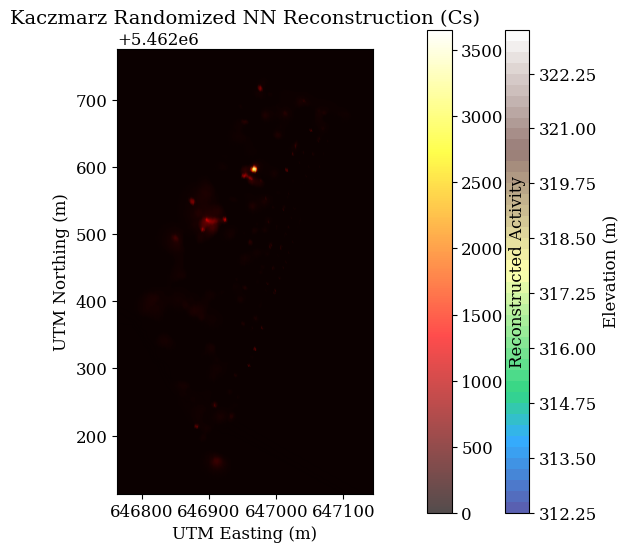


Plotting Residuals Over Iterations (Cesium - Cs)...


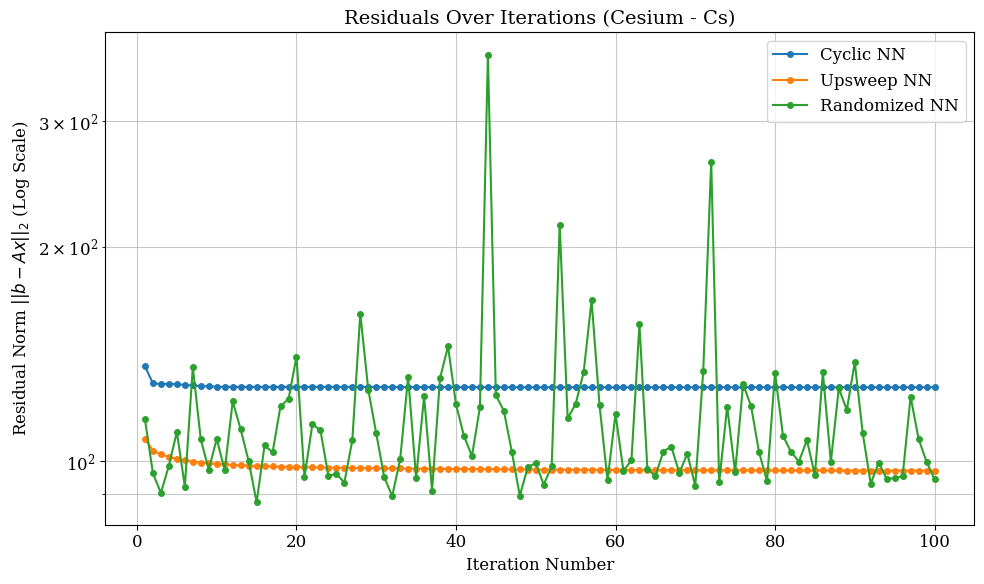


--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---

--- Running Kaczmarz Cyclic NN (Co) ---


Cyclic Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [00:48<00:00,  2.05it/s]


Final Residual (Cyclic NN Co): 50.4266

Creating 2D terrain map with reconstruction overlay for Kaczmarz Cyclic NN Reconstruction (Co) (Threshold: 0.0%) ...


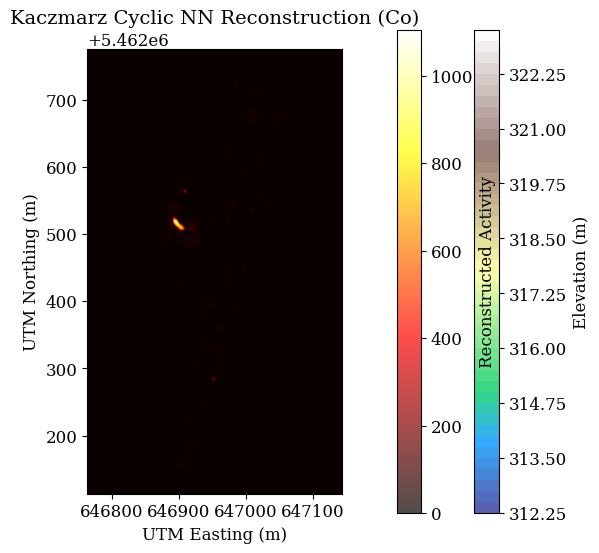


--- Running Kaczmarz Upsweep NN (Co) ---


Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [02:23<00:00,  1.43s/it]


Final Residual (Upsweep NN Co): 48.9527

Creating 2D terrain map with reconstruction overlay for Kaczmarz Upsweep NN Reconstruction (Co) (Threshold: 0.0%) ...


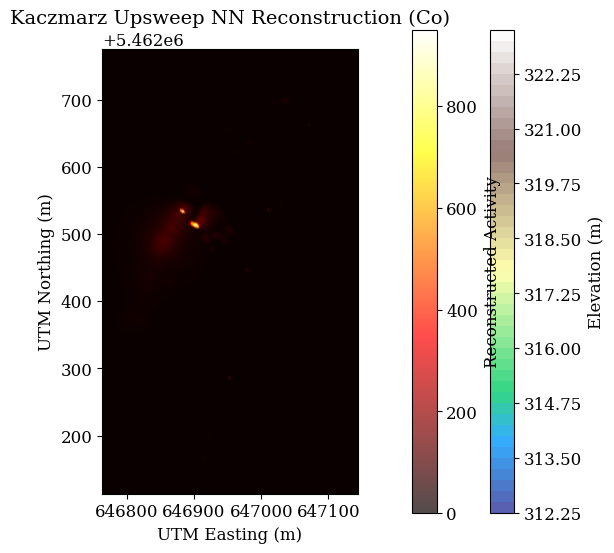


--- Running Kaczmarz Randomized NN (Co) ---


Randomized Kaczmarz NN (CO) Iterations: 100%|██████████| 100/100 [00:38<00:00,  2.59it/s]


Final Residual (Randomized NN Co): 78.5851

Creating 2D terrain map with reconstruction overlay for Kaczmarz Randomized NN Reconstruction (Co) (Threshold: 0.0%) ...


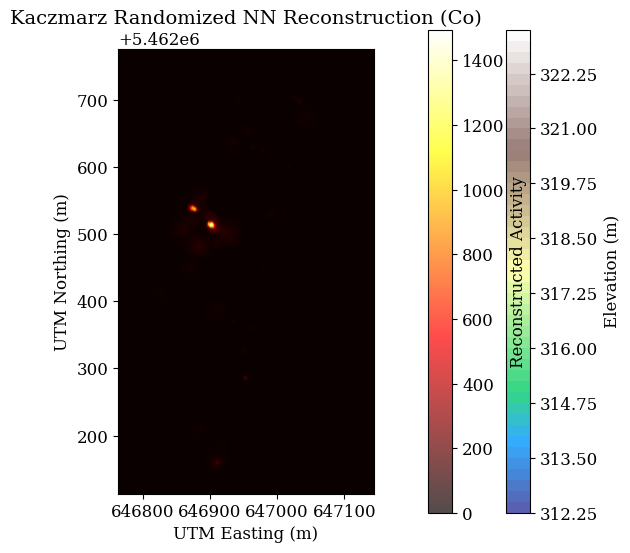


--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---


In [6]:
# --- Run and Plot for Cesium (Cs) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cesium (Cs) ---")
cs_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Cyclic NN (Cs) ---")
x_recon_cyclic_nn_cs, residuals_cyclic_nn_cs = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Cyclic NN'] = residuals_cyclic_nn_cs
print(f"Final Residual (Cyclic NN Cs): {residuals_cyclic_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, 
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Cs)")
# plot_3d_surface_reconstruction(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Cyclic NN (Matplotlib 3D, Cs)")
#plot_3d_plotly_reconstruction(x_recon_cyclic_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Cyclic NN (Plotly 3D, Cs)")


# 2. Kaczmarz Upsweep Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Upsweep NN (Cs) ---")
x_recon_upsweep_nn_cs, residuals_upsweep_nn_cs = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Upsweep NN'] = residuals_upsweep_nn_cs
print(f"Final Residual (Upsweep NN Cs): {residuals_upsweep_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, 
                                    grid_points_for_reconstruction, title="Kaczmarz Upsweep NN Reconstruction (Cs)")
# plot_3d_surface_reconstruction(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Upsweep NN (Matplotlib 3D, Cs)")
#plot_3d_plotly_reconstruction(x_recon_upsweep_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Upsweep NN (Plotly 3D, Cs)")


# 3. Kaczmarz Randomized Non-Negative (NN) (Cs)
print("\n--- Running Kaczmarz Randomized NN (Cs) ---")
x_recon_randomized_nn_cs, residuals_randomized_nn_cs = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, n_iter=kaczmarz_n_iter, isotope_str="cs")
cs_residuals_data['Randomized NN'] = residuals_randomized_nn_cs
print(f"Final Residual (Randomized NN Cs): {residuals_randomized_nn_cs[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, 
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Cs)")
# plot_3d_surface_reconstruction(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Randomized NN (Matplotlib 3D, Cs)")
#plot_3d_plotly_reconstruction(x_recon_randomized_nn_cs, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Randomized NN (Plotly 3D, Cs)")




# Plot Residuals for Cs
plot_residuals_over_iterations(cs_residuals_data, kaczmarz_n_iter, title="Residuals Over Iterations (Cesium - Cs)")


# --- Run and Plot for Cobalt (Co) ---
print("\n--- Running and Plotting Kaczmarz Algorithms for Cobalt (Co) ---")
co_residuals_data = {}

# --- Non-Negative (NN) Algorithms (kept) ---

# 1. Kaczmarz Cyclic Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Cyclic NN (Co) ---")
x_recon_cyclic_nn_co, residuals_cyclic_nn_co = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Cyclic NN'] = residuals_cyclic_nn_co
print(f"Final Residual (Cyclic NN Co): {residuals_cyclic_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, 
                                    grid_points_for_reconstruction, title="Kaczmarz Cyclic NN Reconstruction (Co)")
# plot_3d_surface_reconstruction(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Cyclic NN (Matplotlib 3D, Co)")
#plot_3d_plotly_reconstruction(x_recon_cyclic_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Cyclic NN (Plotly 3D, Co)")


# 2. Kaczmarz Upsweep Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Upsweep NN (Co) ---")
x_recon_upsweep_nn_co, residuals_upsweep_nn_co = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Upsweep NN'] = residuals_upsweep_nn_co
print(f"Final Residual (Upsweep NN Co): {residuals_upsweep_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, 
                                    grid_points_for_reconstruction, title="Kaczmarz Upsweep NN Reconstruction (Co)")
# plot_3d_surface_reconstruction(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Upsweep NN (Matplotlib 3D, Co)")
#plot_3d_plotly_reconstruction(x_recon_upsweep_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Upsweep NN (Plotly 3D, Co)")


# 3. Kaczmarz Randomized Non-Negative (NN) (Co)
print("\n--- Running Kaczmarz Randomized NN (Co) ---")
x_recon_randomized_nn_co, residuals_randomized_nn_co = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, n_iter=kaczmarz_n_iter, isotope_str="co")
co_residuals_data['Randomized NN'] = residuals_randomized_nn_co
print(f"Final Residual (Randomized NN Co): {residuals_randomized_nn_co[-1]:.4f}")
plot_2d_reconstruction_on_terrain_map(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, 
                                    grid_points_for_reconstruction, title="Kaczmarz Randomized NN Reconstruction (Co)")
# plot_3d_surface_reconstruction(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, title="Kaczmarz Randomized NN (Matplotlib 3D, Co)")
#plot_3d_plotly_reconstruction(x_recon_randomized_nn_co, xx_mesh, yy_mesh, Z_terrain_interpolated, grid_points_for_reconstruction, title="Kaczmarz Randomized NN (Plotly 3D, Co)")


# --- Kaczmarz Relaxation (Co) ---


print("\n--- All Kaczmarz algorithms execution and plotting complete for both Cs and Co. ---")

## Early Stopping


--- Running Kaczmarz for Cesium-137 with Early Stopping ---


Kaczmarz Downsweep with Early Stop:   2%|▏         | 18/1000 [00:39<35:50,  2.19s/it] 

Stopping early at iteration 19 due to minimal change in residual.


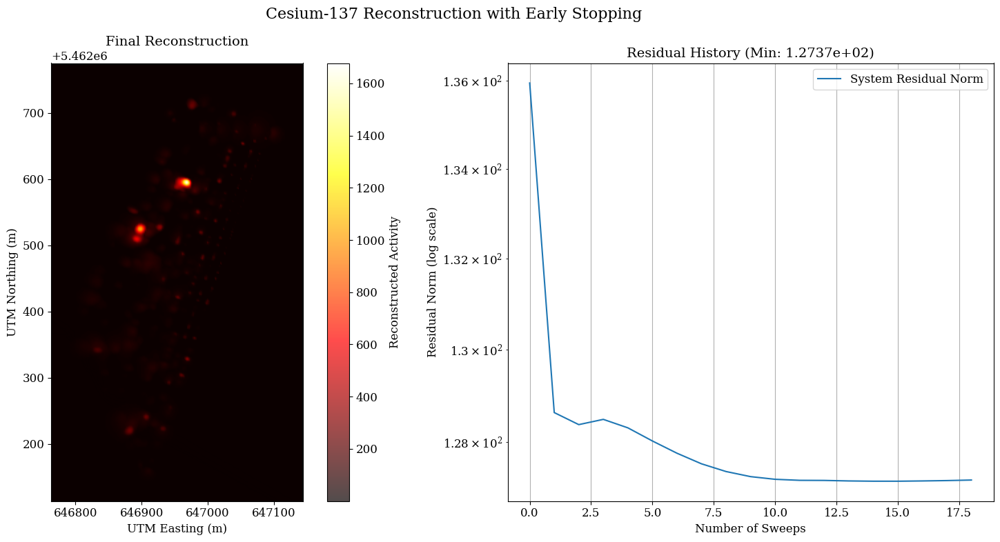


--- Running Kaczmarz for Cobalt-60 with Early Stopping ---


Kaczmarz Downsweep with Early Stop:   1%|          | 12/1000 [00:25<35:01,  2.13s/it] 

Stopping early at iteration 13 due to minimal change in residual.


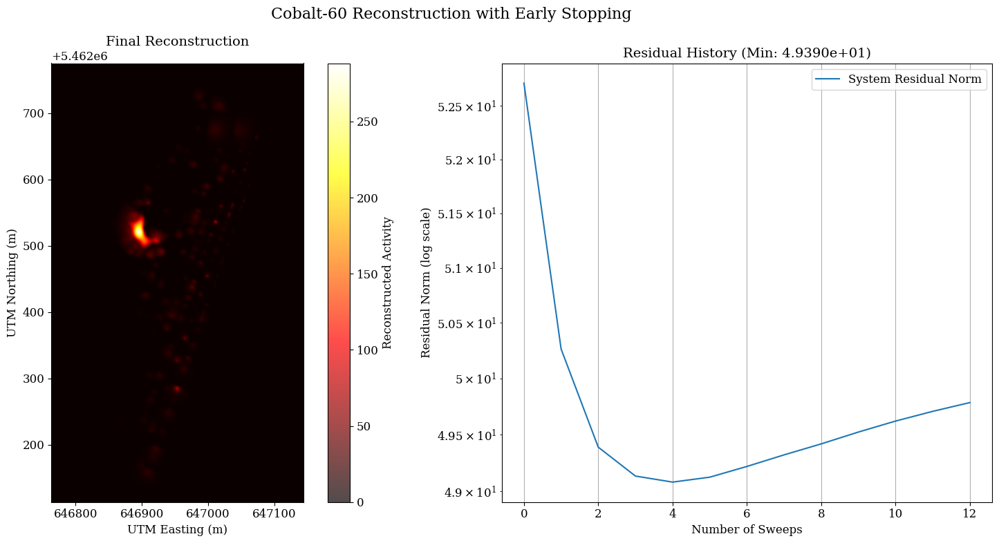


--- All reconstructions and plots have been generated. ---


In [12]:
# --- Run Kaczmarz with Early Stopping for Cesium-137 ---
if __name__ == "__main__":
    print("\n--- Running Kaczmarz for Cesium-137 with Early Stopping ---")
    x_recon_cs_early_stop, min_residual_cs_early_stop, res_history_cs_early_stop = kaczmarz_downsweep_early_stop(
        A=A_matrix_cs, 
        b=b_cs, 
        omega=1,  # A good starting point based on previous runs
        max_iters=1000,
        slack=10,
        tolerance=0.5
    )
    
    # Now you can visualize the results
    plot_reconstruction_and_history(x_recon_cs_early_stop, res_history_cs_early_stop, xx_mesh, yy_mesh, 
                                    Z_terrain_interpolated, grid_points_for_reconstruction, 
                                    detectors, b_cs, "Cesium-137 Reconstruction with Early Stopping", min_residual_cs_early_stop)

    # --- Run Kaczmarz with Early Stopping for Cobalt-60 ---
    print("\n--- Running Kaczmarz for Cobalt-60 with Early Stopping ---")
    x_recon_co_early_stop, min_residual_co_early_stop, res_history_co_early_stop = kaczmarz_downsweep_early_stop(
        A=A_matrix_co, 
        b=b_co, 
        omega=1,  # Use the same or a tuned value
        max_iters=1000,
        slack=10,
        tolerance=0.5
    )

    # Now you can visualize the results
    plot_reconstruction_and_history(x_recon_co_early_stop, res_history_co_early_stop, xx_mesh, yy_mesh, 
                                    Z_terrain_interpolated, grid_points_for_reconstruction, 
                                    detectors, b_co, "Cobalt-60 Reconstruction with Early Stopping", min_residual_co_early_stop)

    print("\n--- All reconstructions and plots have been generated. ---")


Creating side-by-side plot for Early stop (cs) ...


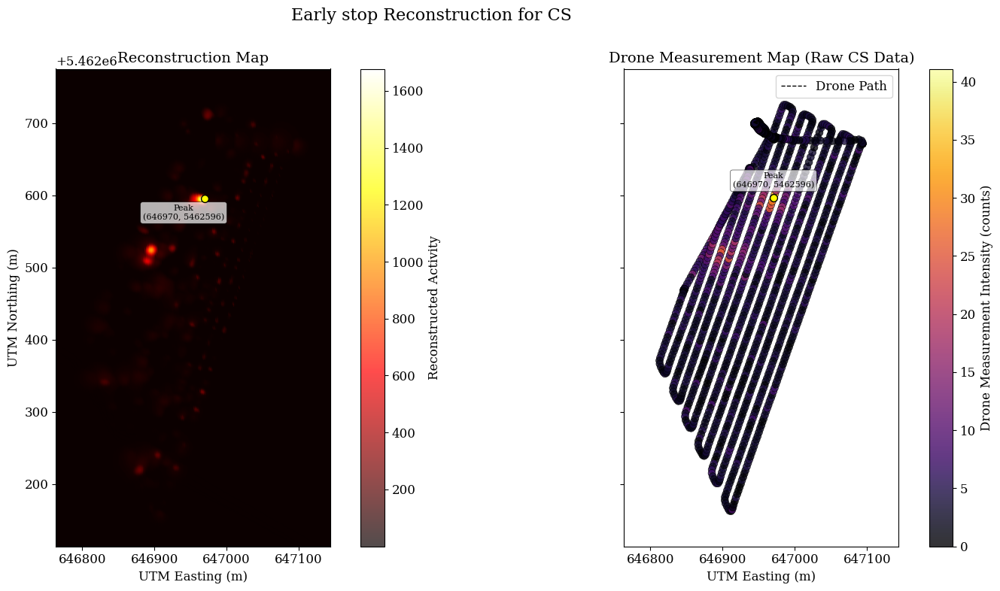


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646969.50, 5462595.50)
Measured Peak Location (UTM): (646970.38, 5462596.50)
Distance between peaks: 1.33 meters

Creating side-by-side plot for Early Stop (co) ...


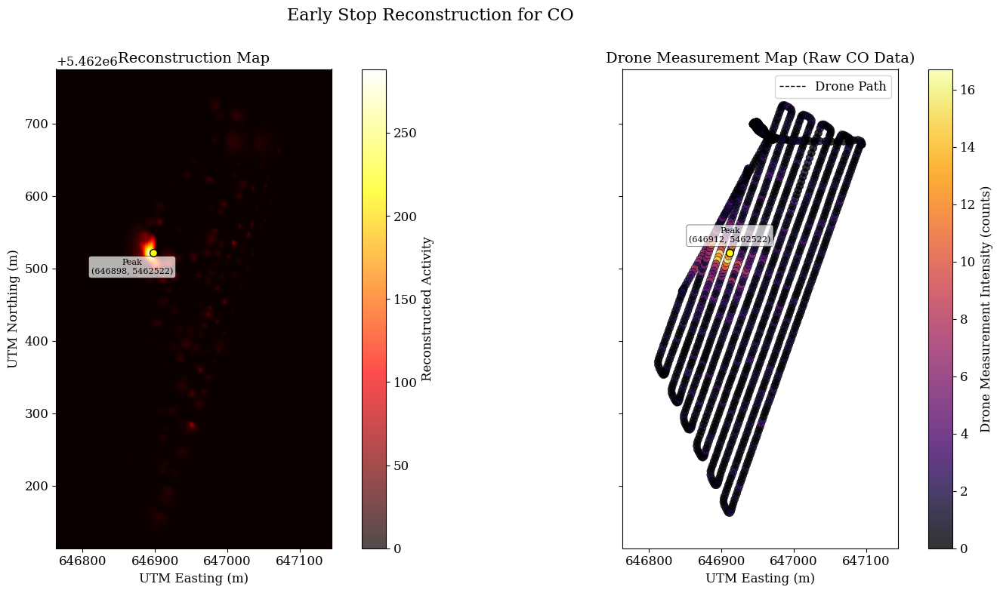


--- Peak Location Comparison ---
Reconstructed Peak Location (UTM): (646897.50, 5462521.50)
Measured Peak Location (UTM): (646911.75, 5462521.50)
Distance between peaks: 14.25 meters


In [14]:
def plot_reconstruction_and_measurements_side_by_side2(x_recon, xx_mesh, yy_mesh, Z_terrain,
                                                     grid_points_for_reconstruction, detectors,
                                                     b_values, algo_name, isotope_str,
                                                     threshold_percentage=0.0):
    print(f"\nCreating side-by-side plot for {algo_name} ({isotope_str}) ...")

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8), sharex=True, sharey=True)
    fig.suptitle(f"{algo_name} Reconstruction for {isotope_str.upper()}", fontsize=16)

    # --- Left Subplot: Reconstruction Map ---
    # Plot the terrain elevation as a background
    contour_levels = 50
    ax1.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    scatter_x = grid_points_for_reconstruction[:, 0]
    scatter_y = grid_points_for_reconstruction[:, 1]
    reconstruction_plot = ax1.scatter(scatter_x, scatter_y, c=x_recon,
                                     cmap='hot', s=50, alpha=0.7, edgecolors='none')
    fig.colorbar(reconstruction_plot, ax=ax1, label="Reconstructed Activity", pad=0.05)

    # Find and plot the highest reconstruction point
    max_recon_idx = np.argmax(x_recon)
    max_recon_loc = grid_points_for_reconstruction[max_recon_idx]
    ax1.scatter(max_recon_loc[0], max_recon_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax1.annotate(f"Peak\n({max_recon_loc[0]:.0f}, {max_recon_loc[1]:.0f})",
                 (max_recon_loc[0], max_recon_loc[1]),
                 textcoords="offset points", xytext=(-20,-20), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    ax1.set_title("Reconstruction Map")
    ax1.set_xlabel("UTM Easting (m)")
    ax1.set_ylabel("UTM Northing (m)")
    ax1.set_aspect('equal', adjustable='box')

    # --- Right Subplot: Drone Measurements ---
    # Plot the terrain elevation as a background
    #ax2.contourf(xx_mesh, yy_mesh, Z_terrain, levels=contour_levels, cmap='terrain', alpha=0.8)

    # Plot the drone flight path
    ax2.plot(detectors[:, 0], detectors[:, 1], color='black', linestyle='--', linewidth=1, zorder=2, label='Drone Path')

    # Plot the "true hotspot" measurements from the drone
    scatter_drone = ax2.scatter(detectors[:, 0], detectors[:, 1],
                               c=b_values, cmap='inferno', s=50, alpha=0.8,
                               edgecolors='black', linewidth=0.5, zorder=3)

    # Find and plot the highest drone measurement point
    max_b_idx = np.argmax(b_values)
    max_b_loc = detectors[max_b_idx]
    ax2.scatter(max_b_loc[0], max_b_loc[1], s=50, marker='o', c='yellow', edgecolors='black', zorder=5)
    ax2.annotate(f"Peak\n({max_b_loc[0].round(2):.0f}, {max_b_loc[1].round(2):.0f})",
                 (max_b_loc[0], max_b_loc[1]),
                 textcoords="offset points", xytext=(0,10), ha='center', fontsize=8,
                 bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=0.5, alpha=0.7))

    # Add a colorbar for the drone measurements
    fig.colorbar(scatter_drone, ax=ax2, label="Drone Measurement Intensity (counts)", pad=0.05)

    # Add arrow to indicate start of path
    if len(detectors) > 1:
        ax2.arrow(detectors[0, 0], detectors[0, 1],
                  detectors[1, 0] - detectors[0, 0], detectors[1, 1] - detectors[0, 1],
                  head_width=5, head_length=5, fc='black', ec='black', zorder=4)

    ax2.set_title(f"Drone Measurement Map (Raw {isotope_str.upper()} Data)")
    ax2.set_xlabel("UTM Easting (m)")
    ax2.set_aspect('equal', adjustable='box')
    ax2.legend()

    plt.tight_layout()
    plt.show()

    # --- Print the comparison ---
    print("\n--- Peak Location Comparison ---")
    print(f"Reconstructed Peak Location (UTM): ({max_recon_loc[0]:.2f}, {max_recon_loc[1]:.2f})")
    print(f"Measured Peak Location (UTM): ({max_b_loc[0]:.2f}, {max_b_loc[1]:.2f})")
    distance = np.linalg.norm(max_recon_loc[:2] - max_b_loc[:2])
    print(f"Distance between peaks: {distance:.2f} meters")

plot_reconstruction_and_measurements_side_by_side2(x_recon_cs_early_stop, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_cs, "Early stop", "cs")

plot_reconstruction_and_measurements_side_by_side2(x_recon_co_early_stop, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                  grid_points_for_reconstruction, detectors,
                                                  b_co, "Early Stop", "co")


--- Running Kaczmarz for Cesium-137 with Early Stopping ---


Kaczmarz Downsweep with Early Stop:  11%|█         | 108/1000 [05:40<46:52,  3.15s/it] 

Stopping early at iteration 109 due to minimal change in residual.


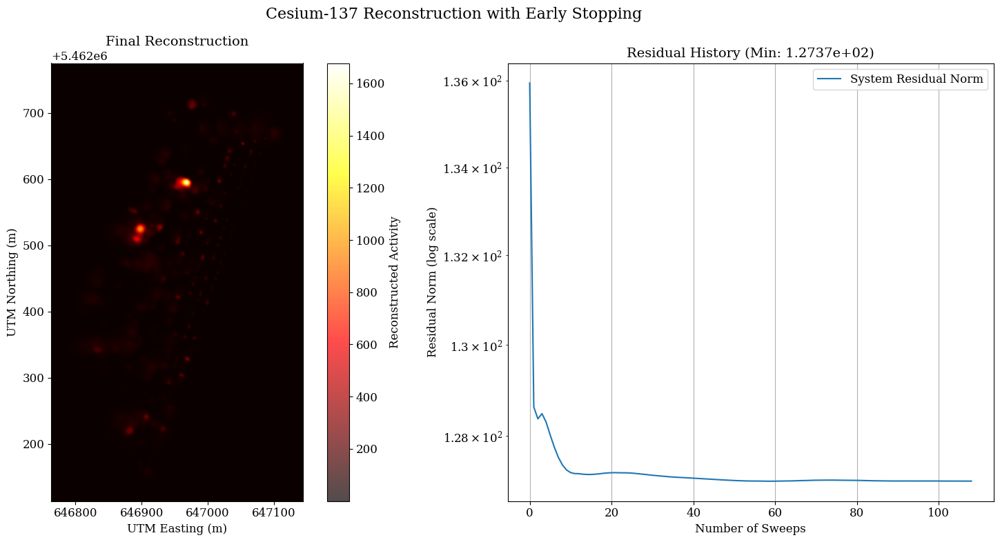


--- Running Kaczmarz for Cobalt-60 with Early Stopping ---


Kaczmarz Downsweep with Early Stop:  10%|█         | 102/1000 [05:27<48:04,  3.21s/it]  

Stopping early at iteration 103 due to minimal change in residual.


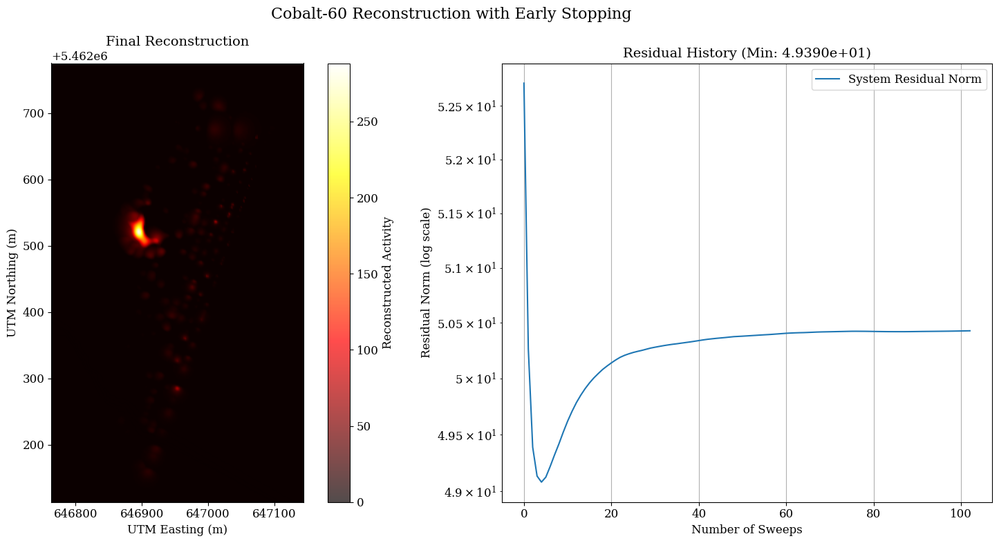


--- All reconstructions and plots have been generated. ---


In [8]:
# --- Run Kaczmarz with Early Stopping for Cesium-137 ---
if __name__ == "__main__":
    print("\n--- Running Kaczmarz for Cesium-137 with Early Stopping ---")
    x_recon_cs_early_stop, min_residual_cs_early_stop, res_history_cs_early_stop = kaczmarz_downsweep_early_stop(
        A=A_matrix_cs, 
        b=b_cs, 
        omega=1,  # A good starting point based on previous runs
        max_iters=1000,
        slack=100,
        tolerance=0.5
    )
    
    # Now you can visualize the results
    plot_reconstruction_and_history(x_recon_cs_early_stop, res_history_cs_early_stop, xx_mesh, yy_mesh, 
                                    Z_terrain_interpolated, grid_points_for_reconstruction, 
                                    detectors, b_cs, "Cesium-137 Reconstruction with Early Stopping", min_residual_cs_early_stop)

    # --- Run Kaczmarz with Early Stopping for Cobalt-60 ---
    print("\n--- Running Kaczmarz for Cobalt-60 with Early Stopping ---")
    x_recon_co_early_stop, min_residual_co_early_stop, res_history_co_early_stop = kaczmarz_downsweep_early_stop(
        A=A_matrix_co, 
        b=b_co, 
        omega=1,  # Use the same or a tuned value
        max_iters=1000,
        slack=100,
        tolerance=0.5
    )

    # Now you can visualize the results
    plot_reconstruction_and_history(x_recon_co_early_stop, res_history_co_early_stop, xx_mesh, yy_mesh, 
                                    Z_terrain_interpolated, grid_points_for_reconstruction, 
                                    detectors, b_co, "Cobalt-60 Reconstruction with Early Stopping", min_residual_co_early_stop)

    print("\n--- All reconstructions and plots have been generated. ---")

## Twin error Gauge


--- Running TEG Kaczmarz for Cesium-137 ---


TEG Kaczmarz Sweeps:   0%|          | 50/10000 [02:33<8:27:41,  3.06s/it] 

Stopping at iteration 51 with minimal gauge 1.2813e+00


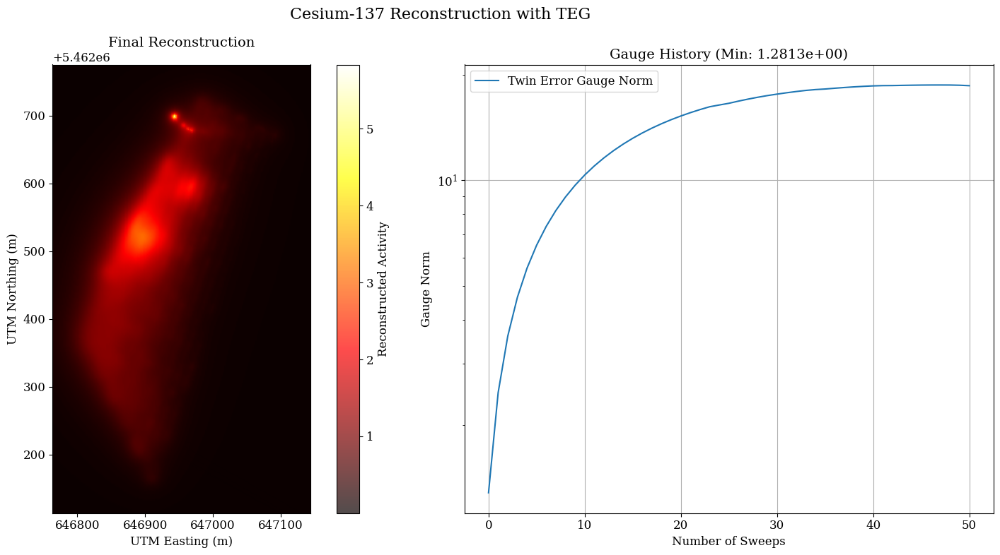


--- Running TEG Kaczmarz for Cobalt-60 ---


TEG Kaczmarz Sweeps:   0%|          | 50/10000 [02:05<6:55:11,  2.50s/it]

Stopping at iteration 51 with minimal gauge 4.6548e-01


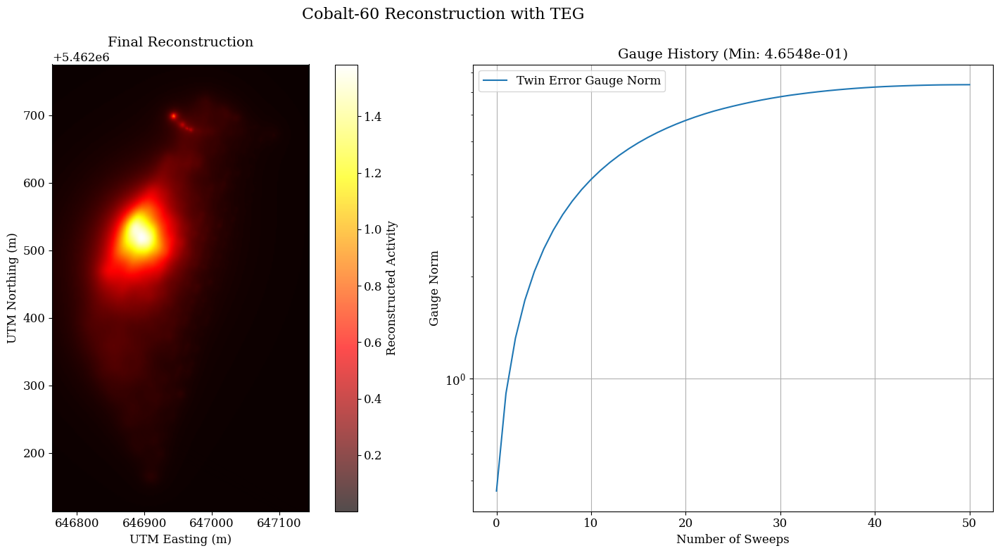


--- All TEG reconstructions and plots have been generated. ---


In [9]:
# --- Twin Error Gauge Execution and Plotting ---
if __name__ == '__main__':    
    # Run for Cesium
    print("\n--- Running TEG Kaczmarz for Cesium-137 ---")
    x_recon_cs, gauge_history_cs, min_gauge_cs = twin_error_gauge_kaczmarz(
        A_matrix_cs, b_cs, omega=0.0005, max_iters=10000, slack=50
    )
    plot_reconstruction_and_gauge(x_recon_cs, gauge_history_cs, xx_mesh, yy_mesh, 
                                  Z_terrain_interpolated, grid_points_for_reconstruction, 
                                  detectors, b_cs, "Cesium-137 Reconstruction with TEG", min_gauge_cs)
    
    # Run for Cobalt
    print("\n--- Running TEG Kaczmarz for Cobalt-60 ---")
    x_recon_co, gauge_history_co, min_gauge_co = twin_error_gauge_kaczmarz(
        A_matrix_co, b_co, omega=0.0005, max_iters=10000, slack=50
    )
    plot_reconstruction_and_gauge(x_recon_co, gauge_history_co, xx_mesh, yy_mesh, 
                                  Z_terrain_interpolated, grid_points_for_reconstruction, 
                                  detectors, b_co, "Cobalt-60 Reconstruction with TEG", min_gauge_co)

    print("\n--- All TEG reconstructions and plots have been generated. ---")

# Adding noise


--- Adding Poisson Noise to data ---

--- Running all algorithms on noisy data for both isotopes ---

Running Cyclic NN for Cs...


Cyclic Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [05:43<00:00,  1.17it/s]


Final Residual (Cyclic NN Cs): 144.6687

Creating 2D terrain map with reconstruction overlay for Cyclic NN Reconstruction (Cs) (Threshold: 0.0%) ...


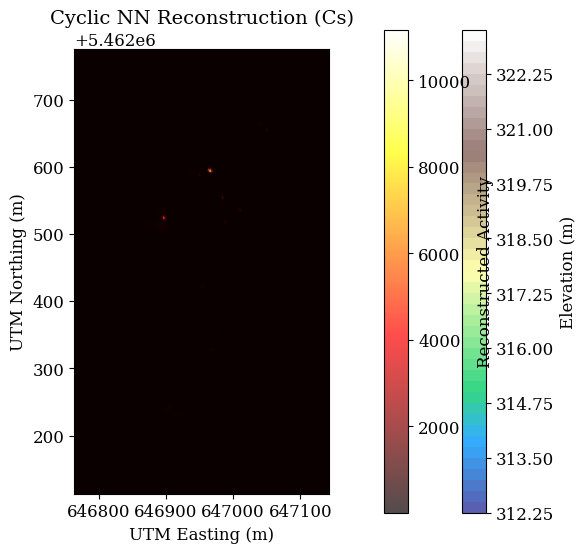


Creating Plotly 3D interactive plot for Cyclic NN 3D Reconstruction (Cs)...



Creating side-by-side plot for Cyclic NN (Cs) ...


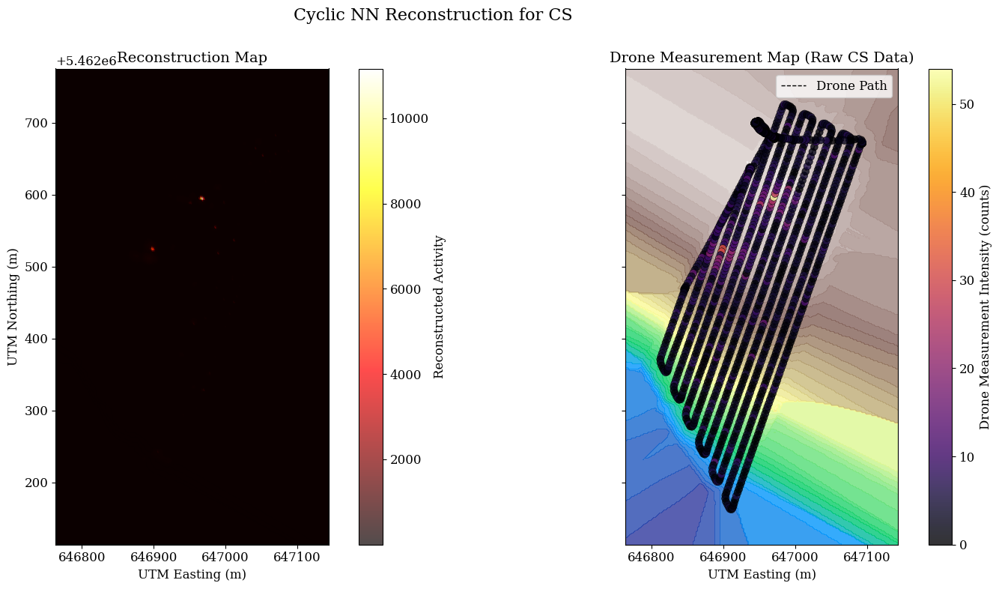


Running Upsweep NN for Cs...


Upsweep Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [10:35<00:00,  1.59s/it]


Final Residual (Upsweep NN Cs): 124.2817

Creating 2D terrain map with reconstruction overlay for Upsweep NN Reconstruction (Cs) (Threshold: 0.0%) ...


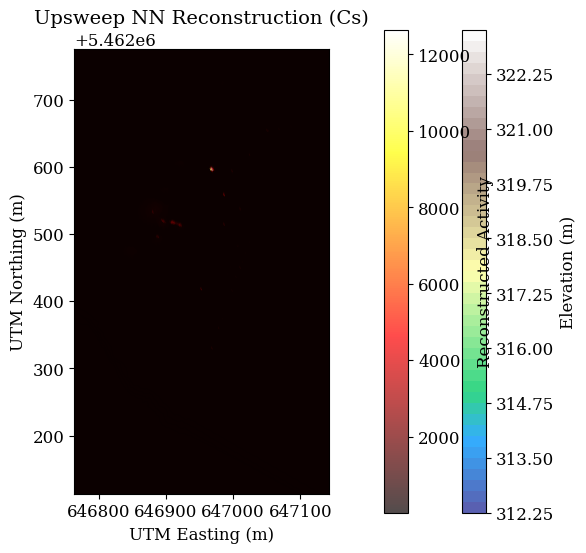


Creating Plotly 3D interactive plot for Upsweep NN 3D Reconstruction (Cs)...



Creating side-by-side plot for Upsweep NN (Cs) ...


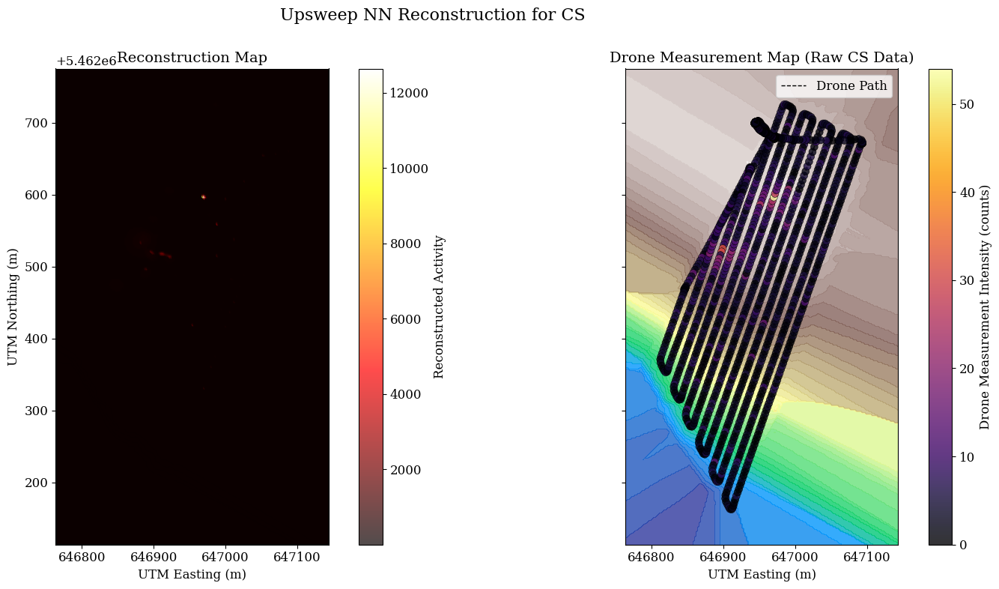


Running Randomized NN for Cs...


Randomized Kaczmarz NN (CS) Iterations: 100%|██████████| 400/400 [03:28<00:00,  1.92it/s]


Final Residual (Randomized NN Cs): 152.9417

Creating 2D terrain map with reconstruction overlay for Randomized NN Reconstruction (Cs) (Threshold: 0.0%) ...


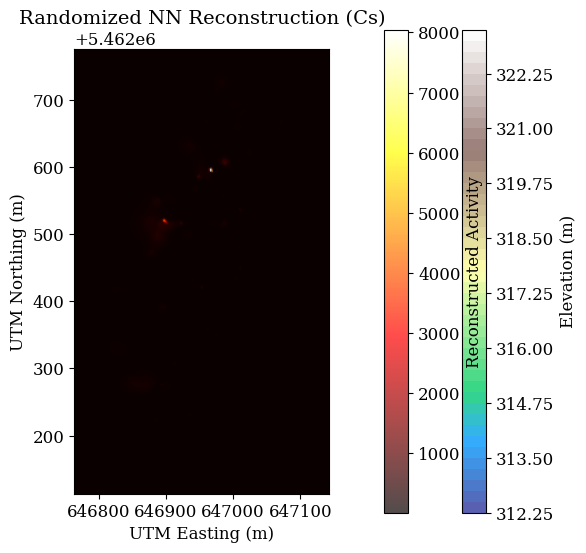


Creating Plotly 3D interactive plot for Randomized NN 3D Reconstruction (Cs)...



Creating side-by-side plot for Randomized NN (Cs) ...


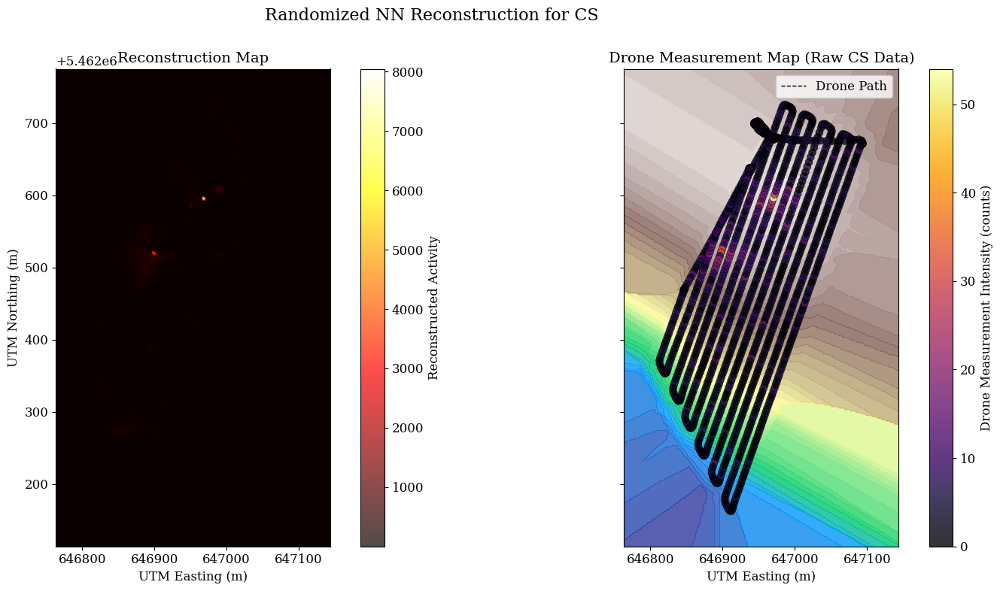


Running Cyclic NN for Co...


Cyclic Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [03:27<00:00,  1.93it/s]


Final Residual (Cyclic NN Co): 69.9403

Creating 2D terrain map with reconstruction overlay for Cyclic NN Reconstruction (Co) (Threshold: 0.0%) ...


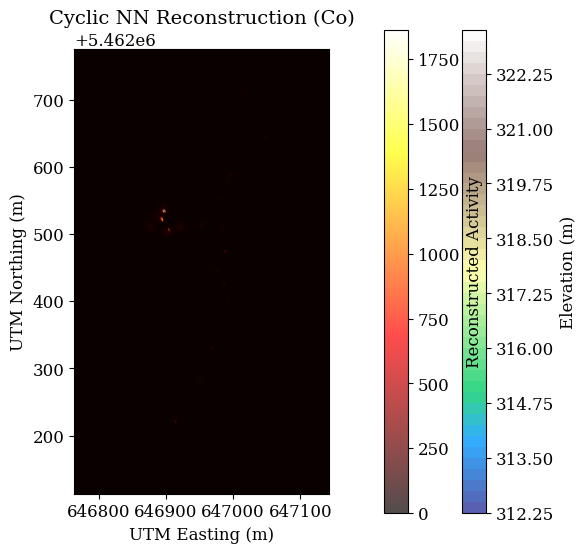


Creating Plotly 3D interactive plot for Cyclic NN 3D Reconstruction (Co)...



Creating side-by-side plot for Cyclic NN (Co) ...


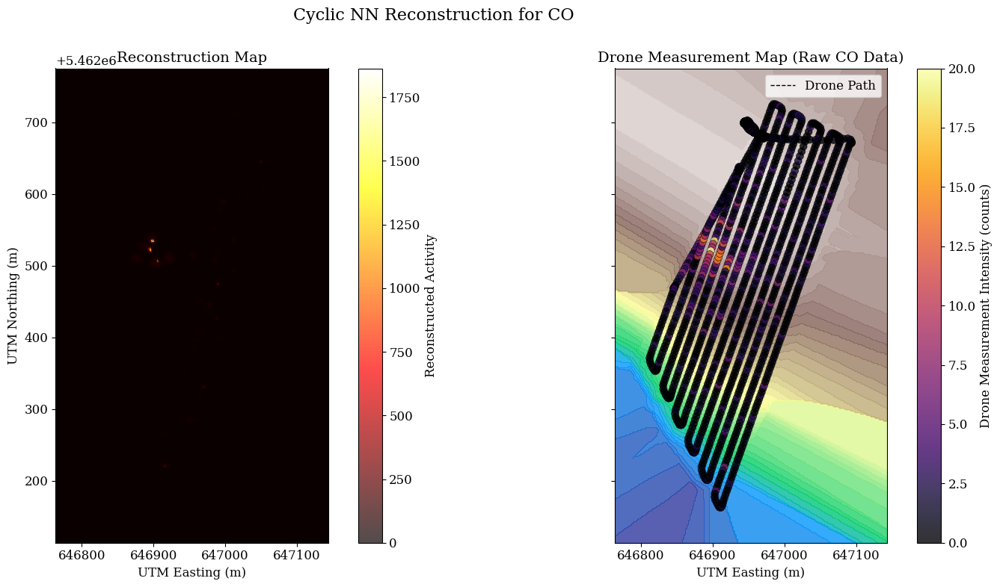


Running Upsweep NN for Co...


Upsweep Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [10:45<00:00,  1.61s/it]


Final Residual (Upsweep NN Co): 63.9547

Creating 2D terrain map with reconstruction overlay for Upsweep NN Reconstruction (Co) (Threshold: 0.0%) ...


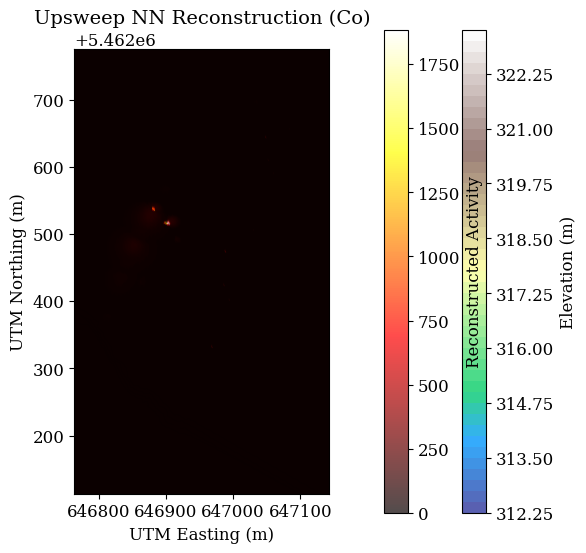


Creating Plotly 3D interactive plot for Upsweep NN 3D Reconstruction (Co)...



Creating side-by-side plot for Upsweep NN (Co) ...


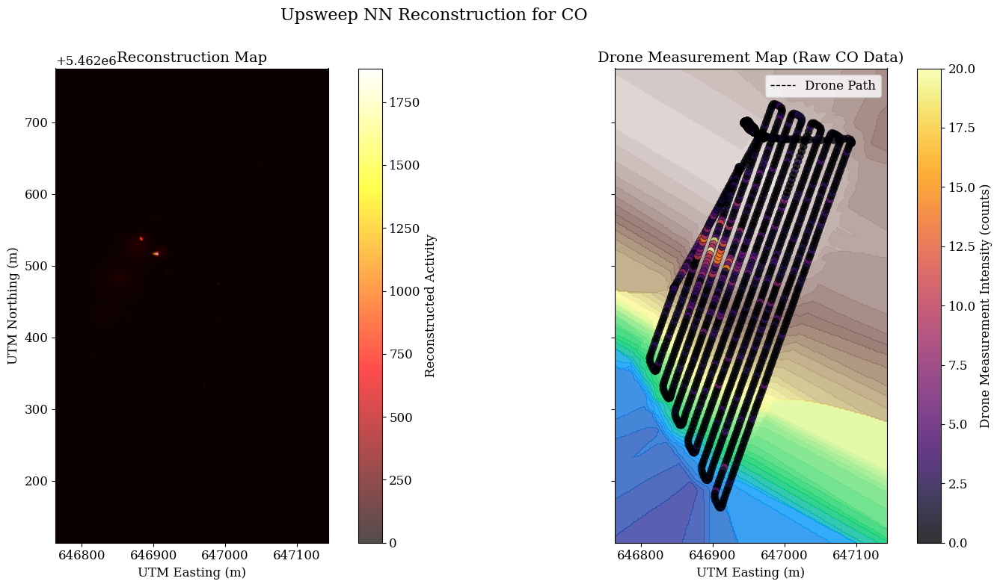


Running Randomized NN for Co...


Randomized Kaczmarz NN (CO) Iterations: 100%|██████████| 400/400 [03:31<00:00,  1.89it/s]


Final Residual (Randomized NN Co): 119.9983

Creating 2D terrain map with reconstruction overlay for Randomized NN Reconstruction (Co) (Threshold: 0.0%) ...


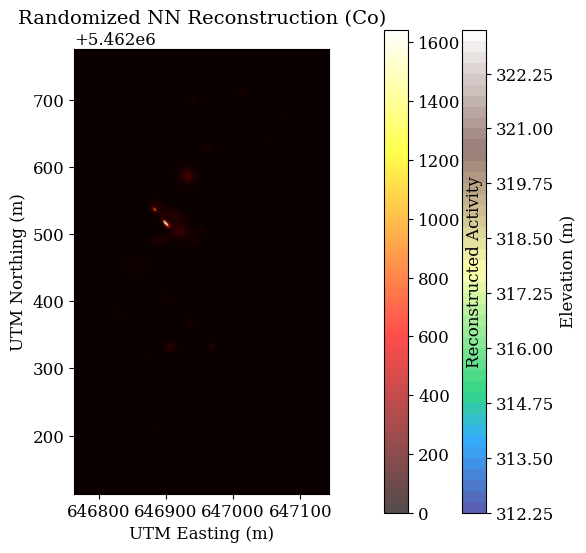


Creating Plotly 3D interactive plot for Randomized NN 3D Reconstruction (Co)...



Creating side-by-side plot for Randomized NN (Co) ...


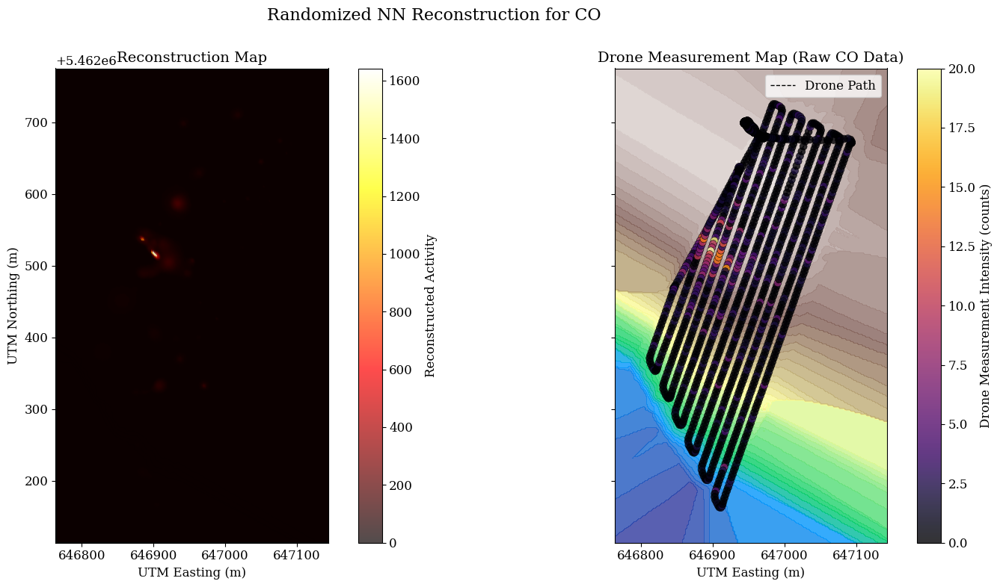


--- Plotting residuals for comparison ---

Plotting Residuals Over Iterations (Cesium - Cs)...


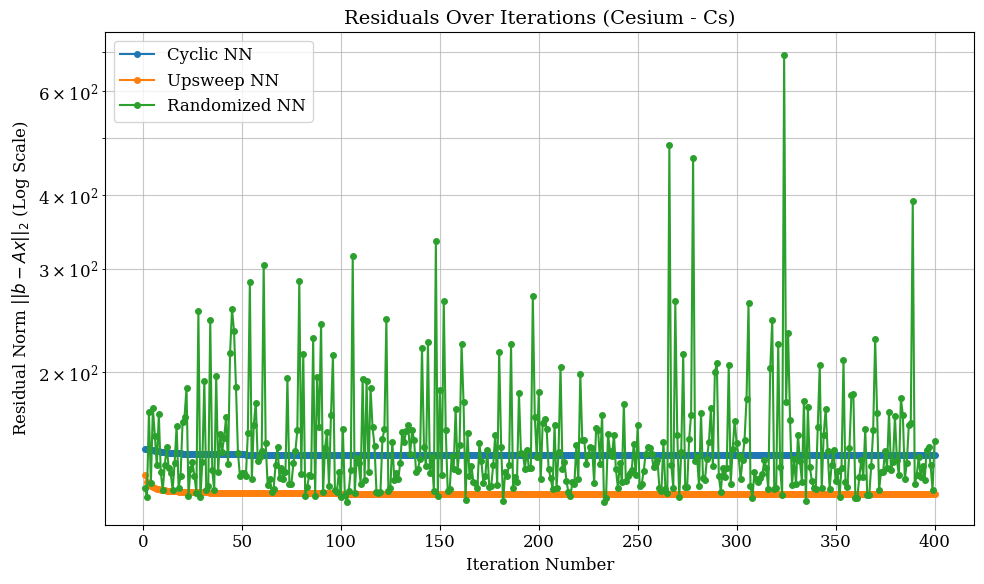


Plotting Residuals Over Iterations (Cobalt - Co)...


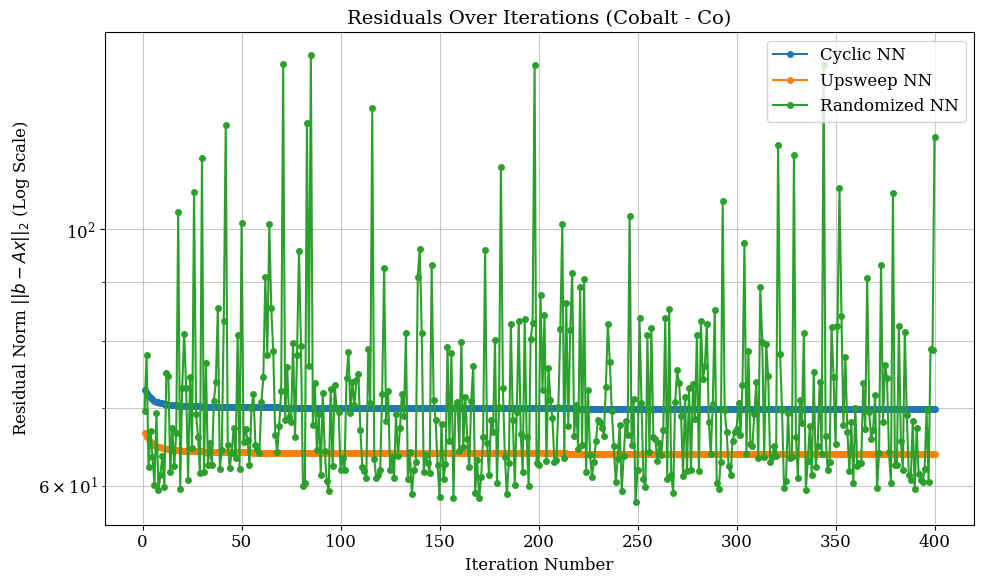


--- All algorithms execution and plotting complete for both Cs and Co. ---


In [ ]:
def add_poisson_noise(b, seed=None):
    """
    Generate Poisson-noised measurements from expected counts b.
    Ensures non-negative; returns floats/ints depending on numpy version.
    """
    rng = np.random.default_rng(seed)
    # Poisson requires non-negative means
    b_pos = np.clip(b, 0, None)
    noisy = rng.poisson(lam=b_pos)
    return noisy.astype(float)

# 2. Add Poisson Noise to Data
print("\n--- Adding Poisson Noise to data ---")
b_cs_noisy = add_poisson_noise(b_cs, seed=42)
b_co_noisy = add_poisson_noise(b_co, seed=42)

# 3. Define Algorithms and Isotope Data for the Loop
kaczmarz_n_iter = 400
algorithms = {
    'Cyclic NN': kaczmarz_cyclic_nn,
    'Upsweep NN': kaczmarz_upsweep_nn,
    'Randomized NN': kaczmarz_randomized_nn
}
isotopes = {
    'Cs': (b_cs_noisy, b_cs, A_matrix_cs),
    'Co': (b_co_noisy, b_co, A_matrix_co)
}

# 4. Main Loop to run all algorithms on noisy data and plot
print("\n--- Running all algorithms on noisy data for both isotopes ---")
all_residuals_data = {}

for isotope_name, (b_noisy, b_original, A_matrix) in isotopes.items():
    all_residuals_data[isotope_name] = {}
    for algo_name, algo_func in algorithms.items():
        print(f"\nRunning {algo_name} for {isotope_name}...")
        
        # NOTE: Pass the noisy 'b_noisy' vector to the algorithm
        x_recon, residuals_history = algo_func(detectors, grid_points_for_reconstruction, b_noisy, A_matrix, n_iter=kaczmarz_n_iter, isotope_str=isotope_name)
        
        # The residuals_history is calculated against the original, noiseless 'b'
        all_residuals_data[isotope_name][algo_name] = residuals_history
        
        final_residual = residuals_history[-1]
        print(f"Final Residual ({algo_name} {isotope_name}): {final_residual:.4f}")

        # --- PLOTTING SECTION ---
        # Plot the 2D reconstruction
        # plot_2d_reconstruction_on_terrain_map(x_recon, xx_mesh, yy_mesh, Z_terrain_interpolated, 
        #                                       grid_points_for_reconstruction, 
        #                                       title=f"{algo_name} Reconstruction ({isotope_name})")

        # Plot the 3D interactive plot
        # plot_3d_plotly_reconstruction(x_recon, xx_mesh, yy_mesh, Z_terrain_interpolated, 
        #                              grid_points_for_reconstruction, 
        #                              title=f"{algo_name} 3D Reconstruction ({isotope_name})")

        # Plot the side-by-side reconstruction and measurements
        plot_reconstruction_and_measurements_side_by_side(x_recon, xx_mesh, yy_mesh, Z_terrain_interpolated,
                                                         grid_points_for_reconstruction, detectors, 
                                                         b_noisy, algo_name, isotope_name)
        
# 5. Plot Residuals for both isotopes
print("\n--- Plotting residuals for comparison ---")
plot_residuals_over_iterations(all_residuals_data['Cs'], kaczmarz_n_iter, "Residuals Over Iterations (Cesium - Cs)")
plot_residuals_over_iterations(all_residuals_data['Co'], kaczmarz_n_iter, "Residuals Over Iterations (Cobalt - Co)")

print("\n--- All algorithms execution and plotting complete for both Cs and Co. ---")

# Re-try

In [2]:
# Run the 3 basic Kaczmarz variants with relx=1 and plot residuals side by side

relx = 1
n_iter = 100

# Cesium (Cs)
x_cyclic_cs, res_cyclic_cs = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, relx=relx, n_iter=n_iter, isotope_str="cs")
x_upsweep_cs, res_upsweep_cs = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, relx=relx, n_iter=n_iter, isotope_str="cs")
x_randomized_cs, res_randomized_cs = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_cs, A_matrix_cs, relx=relx, n_iter=n_iter, isotope_str="cs")

# Cobalt (Co)
x_cyclic_co, res_cyclic_co = kaczmarz_cyclic_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, relx=relx, n_iter=n_iter, isotope_str="co")
x_upsweep_co, res_upsweep_co = kaczmarz_upsweep_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, relx=relx, n_iter=n_iter, isotope_str="co")
x_randomized_co, res_randomized_co = kaczmarz_randomized_nn(detectors, grid_points_for_reconstruction, b_co, A_matrix_co, relx=relx, n_iter=n_iter, isotope_str="co")

# Plot residuals side by side for Cs
residuals_cs = {
    "Cyclic (relx=1)": res_cyclic_cs,
    "Upsweep (relx=1)": res_upsweep_cs,
    "Randomized (relx=1)": res_randomized_cs
}
plot_residuals_over_iterations(residuals_cs, n_iter, title="Residuals Over Iterations (Cesium - relx=1)")

# Plot residuals side by side for Co
residuals_co = {
    "Cyclic (relx=1)": res_cyclic_co,
    "Upsweep (relx=1)": res_upsweep_co,
    "Randomized (relx=1)": res_randomized_co
}
plot_residuals_over_iterations(residuals_co, n_iter, title="Residuals Over Iterations (Cobalt - relx=1)")

NameError: name 'kaczmarz_cyclic_nn' is not defined